In [1]:
import os
import numpy as np
import librosa
import librosa.display
import tensorflow as tf
from sklearn.model_selection import train_test_split
from sklearn.metrics import confusion_matrix, classification_report
import matplotlib.pyplot as plt
import plotly.graph_objects as go
import seaborn as sns

In [2]:
# Constants
SAMPLE_RATE = 16000
TARGET_LENGTH = 3  # seconds
TARGET_SAMPLES = TARGET_LENGTH * SAMPLE_RATE

# Function to process audio: load, pad or truncate
def process_audio(file_path):
    audio, _ = librosa.load(file_path, sr=SAMPLE_RATE)
    if len(audio) < TARGET_SAMPLES:
        # Pad with zeros (silence)
        audio = np.pad(audio, (0, TARGET_SAMPLES - len(audio)), 'constant')
    else:
        # Truncate
        audio = audio[:TARGET_SAMPLES]
    return audio

# Function to load audio files and convert to spectrograms
def load_audio_files(path, label):
    data = []
    for file in os.listdir(path):
        file_path = os.path.join(path, file)
        audio = process_audio(file_path)  # Process audio
        spectrogram = np.abs(librosa.stft(audio, n_fft=2048, hop_length=512))
        
        # Ensure consistent width
        if spectrogram.shape[1] < 100:  # If it's narrower than 100
            # Pad with zeros (silence) on the right
            padding = 100 - spectrogram.shape[1]
            spectrogram = np.pad(spectrogram, ((0, 0), (0, padding)), 'constant')
        else:  # If it's wider than 100
            # Truncate
            spectrogram = spectrogram[:, :100]
        
        data.append((spectrogram, label))
    return data

In [3]:
# Function to plot the waveform, spectrogram, and MFCCs
def plot_audio_features(audio_path):
    # Load the audio file
    audio, sample_rate = librosa.load(audio_path, sr=None)

    # Plot the waveform
    time = np.linspace(0, len(audio) / sample_rate, num=len(audio))
    fig_waveform = go.Figure()
    fig_waveform.add_trace(go.Scatter(x=time, y=audio, mode='lines', name='Waveform'))
    fig_waveform.update_layout(title='Audio Waveform',
                                xaxis_title='Time (seconds)',
                                yaxis_title='Amplitude',
                                hovermode='x unified')
    
    # Plot the spectrogram
    D = librosa.amplitude_to_db(np.abs(librosa.stft(audio)), ref=np.max)
    fig_spectrogram = go.Figure(data=go.Heatmap(
        z=D,
        x=np.linspace(0, len(audio) / sample_rate, D.shape[1]),
        y=librosa.fft_frequencies(sr=sample_rate),
        colorscale='Viridis'
    ))
    fig_spectrogram.update_layout(title='Spectrogram',
                                   xaxis_title='Time (seconds)',
                                   yaxis_title='Frequency (Hz)',
                                   yaxis=dict(title='Frequency (Hz)', autorange='reversed'))

    # Plot the MFCCs
    mfccs = librosa.feature.mfcc(y=audio, sr=sample_rate, n_mfcc=13)
    fig_mfcc = go.Figure()
    for i in range(mfccs.shape[0]):
        fig_mfcc.add_trace(go.Scatter(x=np.arange(mfccs.shape[1]), y=mfccs[i], mode='lines', name=f'MFCC {i+1}'))
    fig_mfcc.update_layout(title='MFCCs',
                            xaxis_title='Frame',
                            yaxis_title='MFCC Coefficients')

    # Show all plots
    fig_waveform.show()
    fig_spectrogram.show()
    fig_mfcc.show()

In [4]:
def plot_training_history(history):
    plt.figure(figsize=(12, 5))

    plt.subplot(1, 2, 1)
    plt.plot(history.history['accuracy'], label='Train Accuracy')
    plt.plot(history.history['val_accuracy'], label='Validation Accuracy')
    plt.title('Model Accuracy')
    plt.xlabel('Epochs')
    plt.ylabel('Accuracy')
    plt.legend()

    plt.subplot(1, 2, 2)
    plt.plot(history.history['loss'], label='Train Loss')
    plt.plot(history.history['val_loss'], label='Validation Loss')
    plt.title('Model Loss')
    plt.xlabel('Epochs')
    plt.ylabel('Loss')
    plt.legend()

    plt.tight_layout()
    plt.show()

In [5]:
# Load datasets
my_voice_data = load_audio_files('my_voice/', 1)  # Label 1 for your voice
other_voice_data = load_audio_files('other_voice/', 0)  # Label 0 for others
dataset = my_voice_data + other_voice_data

# Shuffle and split data
X = [x[0] for x in dataset]
y = [x[1] for x in dataset]
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Convert to tensors and normalize
X_train = tf.constant(np.array(X_train)[:, :, :100], dtype=tf.float32)  # Truncate for consistency
X_test = tf.constant(np.array(X_test)[:, :, :100], dtype=tf.float32)
y_train = tf.constant(y_train, dtype=tf.float32)
y_test = tf.constant(y_test, dtype=tf.float32)

In [6]:
# Build the model
model = tf.keras.Sequential([
    tf.keras.layers.Conv2D(16, (3, 3), activation='relu', input_shape=(1025, 100, 1)),
    tf.keras.layers.MaxPooling2D((2, 2)),
    tf.keras.layers.Dropout(0.25),

    tf.keras.layers.Conv2D(32, (3, 3), activation='relu'),
    tf.keras.layers.MaxPooling2D((2, 2)),
    tf.keras.layers.Dropout(0.25),

    tf.keras.layers.Conv2D(64, (3, 3), activation='relu'),
    tf.keras.layers.MaxPooling2D((2, 2)),
    tf.keras.layers.Dropout(0.25),

    tf.keras.layers.Flatten(),
    tf.keras.layers.Dense(128, activation='relu'),
    tf.keras.layers.Dropout(0.5),

    tf.keras.layers.Dense(1, activation='sigmoid')
])


In [7]:
# Compile the model
model.compile(optimizer='adam', loss='binary_crossentropy', metrics=['accuracy'])
model.summary()

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d (Conv2D)             (None, 1023, 98, 16)      160       
                                                                 
 max_pooling2d (MaxPooling2D  (None, 511, 49, 16)      0         
 )                                                               
                                                                 
 dropout (Dropout)           (None, 511, 49, 16)       0         
                                                                 
 conv2d_1 (Conv2D)           (None, 509, 47, 32)       4640      
                                                                 
 max_pooling2d_1 (MaxPooling  (None, 254, 23, 32)      0         
 2D)                                                             
                                                                 
 dropout_1 (Dropout)         (None, 254, 23, 32)       0

In [8]:
# Train the model
history = model.fit(X_train[..., np.newaxis], y_train, epochs=10, validation_data=(X_test[..., np.newaxis], y_test))

Epoch 1/10
39/39 [==============================] - 7s 72ms/step - loss: 0.0944 - accuracy: 0.9732 - val_loss: 0.0039 - val_accuracy: 1.0000
Epoch 2/10
39/39 [==============================] - 2s 59ms/step - loss: 0.0050 - accuracy: 0.9959 - val_loss: 0.0019 - val_accuracy: 1.0000
Epoch 3/10
39/39 [==============================] - 2s 55ms/step - loss: 0.0026 - accuracy: 1.0000 - val_loss: 5.2320e-04 - val_accuracy: 1.0000
Epoch 4/10
39/39 [==============================] - 2s 54ms/step - loss: 0.0024 - accuracy: 1.0000 - val_loss: 1.2043e-04 - val_accuracy: 1.0000
Epoch 5/10
39/39 [==============================] - 2s 54ms/step - loss: 0.0027 - accuracy: 0.9992 - val_loss: 6.0968e-05 - val_accuracy: 1.0000
Epoch 6/10
39/39 [==============================] - 2s 54ms/step - loss: 6.5110e-04 - accuracy: 1.0000 - val_loss: 4.0522e-05 - val_accuracy: 1.0000
Epoch 7/10
39/39 [==============================] - 2s 54ms/step - loss: 0.0020 - accuracy: 1.0000 - val_loss: 2.3453e-05 - val_accura

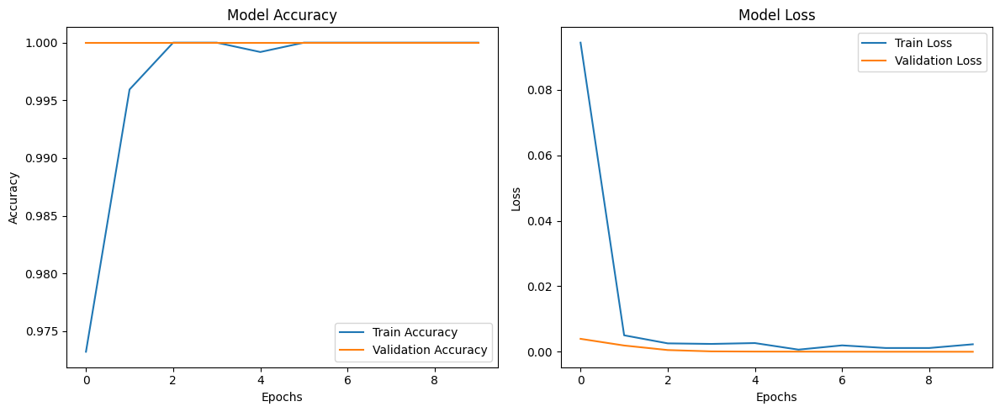

In [9]:
plot_training_history(history)

In [10]:
# Function to predict and welcome or not recognize
def predict_voice(audio_path):
    audio = process_audio(audio_path)  # Process the input audio
    spectrogram = np.abs(librosa.stft(audio, n_fft=2048, hop_length=512))
    
    # Ensure consistent width
    if spectrogram.shape[1] < 100:  # If it's narrower than 100
        # Pad with zeros (silence) on the right
        padding = 100 - spectrogram.shape[1]
        spectrogram = np.pad(spectrogram, ((0, 0), (0, padding)), 'constant')
    else:  # If it's wider than 100
        # Truncate
        spectrogram = spectrogram[:, :100]

    spectrogram = tf.constant(spectrogram[np.newaxis, ..., np.newaxis], dtype=tf.float32)
    prediction = model.predict(spectrogram)
    if prediction >= 0.5:
        print("Welcome, Gunjit!")
    else:
        print("User not recognized.")

In [11]:
path_voice = r"Recording (41).wav"
predict_voice(path_voice)

1/1 [==============================] - 0s 167ms/step
Welcome, Gunjit!


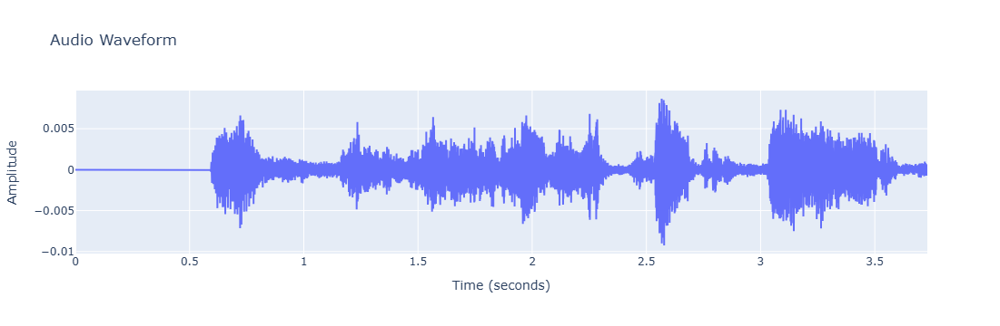

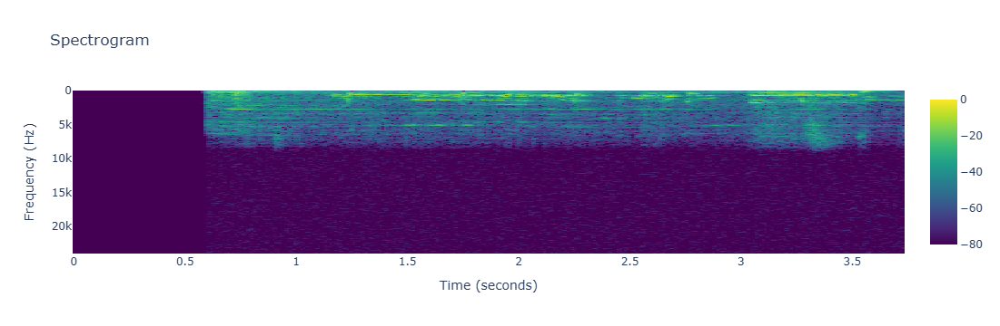

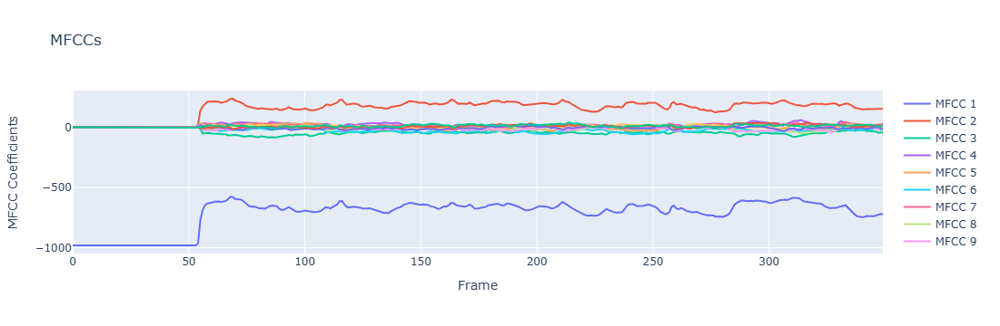

In [13]:
plot_audio_features(path_voice)

In [14]:
path_voice = r"other_voice\1195.wav"
predict_voice(path_voice)

1/1 [==============================] - 0s 17ms/step
User not recognized.


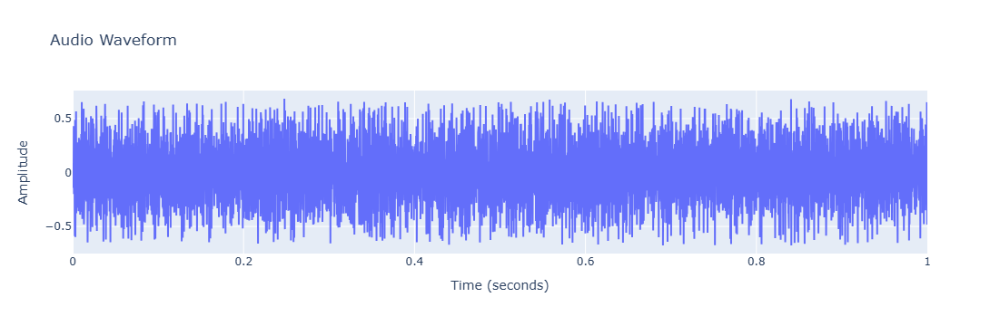

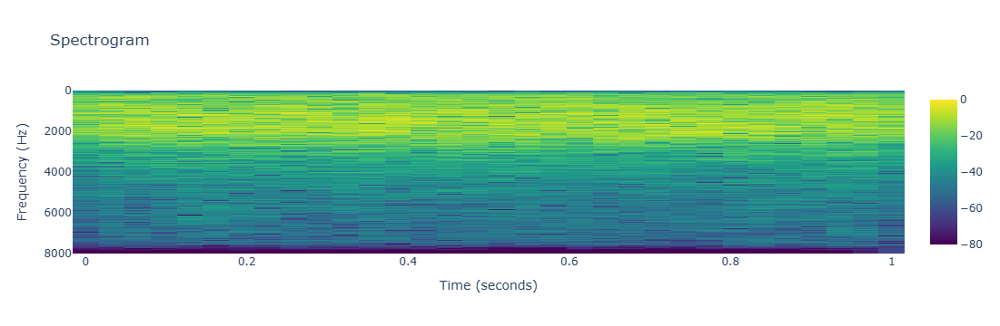

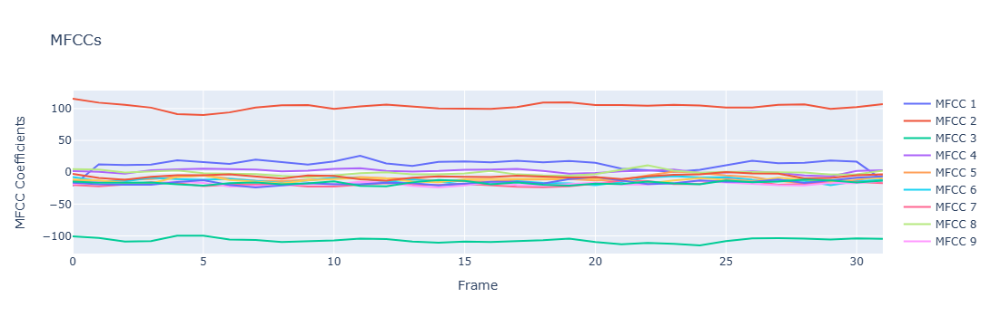

In [15]:
plot_audio_features(path_voice)

10/10 [==============================] - 0s 14ms/step


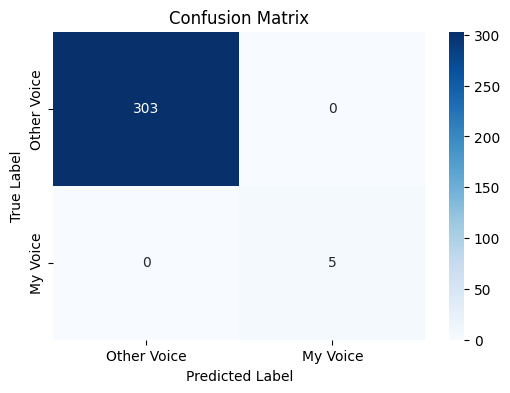

In [16]:
y_pred_probs = model.predict(X_test[..., np.newaxis])
y_pred = (y_pred_probs > 0.5).astype(int)

# Confusion Matrix
cm = confusion_matrix(y_test, y_pred)
plt.figure(figsize=(6, 4))
sns.heatmap(cm, annot=True, fmt='d', cmap='Blues', 
            xticklabels=['Other Voice', 'My Voice'], 
            yticklabels=['Other Voice', 'My Voice'])
plt.xlabel('Predicted Label')
plt.ylabel('True Label')
plt.title('Confusion Matrix')
plt.show()

In [17]:
# Classification Report
print(classification_report(y_test, y_pred, target_names=['Other Voice', 'My Voice']))

              precision    recall  f1-score   support

 Other Voice       1.00      1.00      1.00       303
    My Voice       1.00      1.00      1.00         5

    accuracy                           1.00       308
   macro avg       1.00      1.00      1.00       308
weighted avg       1.00      1.00      1.00       308

